# Pipeline

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

## 1. load parameters

In [2]:
img = mpimg.imread("test_images/test2.jpg")

# 1 camera calib
mtx = np.load("npy/calib_mtx.npy")
dist = np.load("npy/calib_dist.npy")

# 2 thresholding
s_thresh=(170, 255)
sx_thresh=(20, 100)

# 3 perspective transform
img_size=(img.shape[1], img.shape[0])    
src = np.float32(
    [[(img_size[0] / 2) - 59, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 6), img_size[1]],
    [(img_size[0] * 5 / 6) + 50, img_size[1]],
    [(img_size[0] / 2 + 64), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])

def warp(img):
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped, M, Minv

# 4 lane finding
nwindows = 9
margin = 100
minpix = 50

ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

## 2. define pipeline

In [3]:
def pipeline(img):
    # 1 camera calib
    img = cv2.undistort(img, mtx, dist, None, mtx)
    img_orig = np.copy(img)

    # 2-1 color thresholding
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]

    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1

    # 2-2 gradient thresholding
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1

    # 2-3 combined thresholding
    thresholded = np.zeros_like(img[:,:,0])
    thresholded[(sxbinary == 1) | (s_binary == 1)] = 1

    # 3 perspective transform
    binary_warped, _, Minv = warp(thresholded)

    # 4-1 lane finding
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255

    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    window_height = np.int(binary_warped.shape[0]/nwindows)

    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    leftx_current = leftx_base
    rightx_current = rightx_base

    left_lane_inds = []
    right_lane_inds = []

    for window in range(nwindows):
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]

        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # 4-2 fit lane line
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # 4-2 calc radius of curvature
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    # 4-3 calc pos. of vehicle
    lane_center = (left_fitx[-1] + right_fitx[-1])/2
    pos_offset = img.shape[1]/2 - lane_center
    pos_offset = pos_offset*xm_per_pix*100 #cm

    # 4-4 drawing back
    color_warp = np.zeros_like(img).astype(np.uint8)

    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 

    result = cv2.addWeighted(img_orig, 1, newwarp, 0.3, 0)
    
    # 4-5 puttext
    msg1 = 'Left Lane Radius: {0:.2f} m'.format(left_curverad)
    msg2 = 'Right Lane Radius: {0:.2f} m'.format(right_curverad)
    msg3 = 'Vehicle Position : {0:.2f} cm right from center'.format(pos_offset)
    
    cv2.putText(result, msg1, (50,50), cv2.FONT_HERSHEY_COMPLEX, 1, (255,255,255), 2, cv2.LINE_AA)
    cv2.putText(result, msg2, (50,80), cv2.FONT_HERSHEY_COMPLEX, 1, (255,255,255), 2, cv2.LINE_AA)
    cv2.putText(result, msg3, (50,120), cv2.FONT_HERSHEY_COMPLEX, 1, (255,255,255), 2, cv2.LINE_AA)

    return result

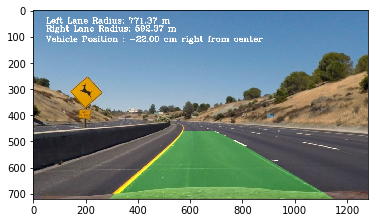

In [4]:
result = pipeline(img)
plt.imshow(result)

## 3. make movie

In [5]:
from moviepy.editor import VideoFileClip

clip = VideoFileClip("project_video.mp4")
clip_out = clip.fl_image(pipeline) #NOTE: this function expects color images!!
%time clip_out.write_videofile("video_out.mp4", audio=False)

[MoviePy] >>>> Building video video_out.mp4
[MoviePy] Writing video video_out.mp4


100%|█████████▉| 1260/1261 [03:07<00:00,  7.01it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: video_out.mp4 

CPU times: user 3min 11s, sys: 42.5 s, total: 3min 53s
Wall time: 3min 8s


In [6]:
from IPython.display import HTML
import io
import base64

video = io.open("video_out.mp4", 'r+b').read()
encoded_video = base64.b64encode(video)
HTML(data='''<video width="640" height="360" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded_video.decode('ascii')))